#<font color="orange" face="Comic Sans MS, Arial">Modelo lineal

##<font color="orange" face="Comic Sans MS, Arial">Introducción







Supongamos que disponemos de un conjunto de $n$ datos (muestra) de la forma

$$(X_1,Y_{1}),(X_2,Y_{2})\dots,(X_n,Y_{n})\in \mathbb{R}^{d}\times\mathbb{R}.$$

Donde $X_n$ representa las características o atributos de los datos y $Y_n$ representa las etiquetas o valores a predecir. En el contexto del aprendizaje automático partiremos del modelo lineal para analizar la relacion entre las variables de este conjunto de datos, se planteará un problema de optimización en el que buscaremos el mejor ajuste para el modelo y finalmente se probaran diversos metodos para obtener dicho ajuste.



###<font color="orange" face="Comic Sans MS, Arial">**Modelo lineal**






La ecuacion del modelo es de la forma

$$ h_w(X) = w_1 X_1 + w_2 X_2 + \dots + w_n X_n, $$

donde
- $ h_w(X) $ es la función de hipótesis que predice el valor de la variable dependiente;
- $ w_1, w_2, \dots, w_n $ son los coeficientes asociados a cada una de las variables independientes;
- $ X_1, X_2, \dots, X_n $ son los vectores de características (variables independientes) en $ \mathbb{R}^d $.

Nota: A priori se busca que este modelo cumpla lo siguiente $Y_i\approx h_w(X_i).$

### <font color="orange" face="Comic Sans MS, Arial">**Funcion de perdida**

Se define la funcion de perdida o costo de la siguiente manera

$$l(X^{(i)},y^{(i)})=(h_w(X^{(i)}) - y^{(i)})^2$$.

###<font color="orange" face="Comic Sans MS, Arial">**Problema de optimización**



El objetivo principal es encontrar los valores óptimos para los coeficientes $w_0, w_1, ..., w_n$ que minimicen el error entre las predicciones del modelo y los valores reales observados. Esto se logra mediante la minimización de una función de perdida,

$$ \operatorname{argmin} \frac{1}{m} \sum_{i=1}^{m} (h_w(X^{(i)}) - y^{(i)})^2 $$.

Donde
* $N$: El número total de observaciones en el conjunto de datos;
* $y_i$: El valor real de Y para la i-ésima observación;
* $h_w(x_i)$: El valor predicho por el modelo para la i-ésima observación.

Típicamente a esta función se le conoce como función de costo cuadrático medio (MSE).

## <font color="orange" face="Comic Sans MS, Arial">Caso de estudio: Modelos lineales para cojuntos de datos en $\mathbb{R}^2$

En este notebook nos limitaremos a ajustar modelos lineales para conjunto de datos de la forma:

$$(X_1,Y_1),(X_2,Y_2),…,(X_n,Y_n)\in\mathbb{R}^2$$

1. ***Modelo lineal***

 Se escoge la función de hipótesis o de predicción $h_w: \mathbb{R}^2 \to \mathbb{R}$ de la siguiente forma

$$ h_w(x) = w \cdot x, $$
donde $w=(w_0,w_1)$ y $x=(1,x)$, es decir,

$$h_w(x) = w_0 + w_1x.$$

<b>Nota.</b>
La razón por la que se considera el vector de caracteristicas $x=(1,x)$ se debe a que de esta forma se puede modelar el término de sesgo o de intercepción ($w_0$) en la regresión lineal, es decir, nos permite ajustar durante el entrenamiento una recta de la forma $y=x\cdot w=(1,x)\cdot (w_0,w_1)=w_0 + w_1x$.

2. ***Función de pérdida***

Se escoge la función de pérdida o costo $l:\mathbb{R}^2\times\mathbb{R}^2\to\mathbb{R}$ como:

$$ l(w,z) = (h_w(x_i) - y_i)^2 ,$$

o simplemente

$$ l(w,z) = ( w_0 + w_1x_i - y_i)^2 .$$

3. ***Problema de optimización***

El objetivo es encontrar $\operatorname{argmin}$ tal que

$$ \operatorname{argmin}  \frac{1}{n} \sum_{k=1}^n l(w, (x_i, y_i)), $$

lo anterior implica encontrar el valor de  $w$  que minimiza el promedio de las pérdidas individuales sobre todos los ejemplos de entrenamiento  $(x_i,y_i)$ , donde  $n$  es el número total de ejemplos de entrenamiento.

##<font color="orange" face="Comic Sans MS, Arial">Método directo

El problema de ajuste de una función lineal, también conocido como regresión lineal, sobre un conjunto de puntos es un problema clásico que ha sido ampliamente estudiado en el campo de la estadística y el aprendizaje automático.
Este tipo de problema se puede resolver de manera directa utilizando métodos de regresión lineal. Estos permiten calcular los coeficientes del modelo directamente, sin necesidad de realizar iteraciones adicionales. Esto contrasta con los métodos iterativos, que producen aproximaciones sucesivas de estos coeficientes con cada iteración. Algunos ejemplos de métodos directos de regresión lineal incluyen:

* Inversión de matriz
* Mínimos cuadrados ordinarios (MCO)
* Descomposición QR

Cada uno de estos métodos tiene sus propias ventajas y limitaciones, y la elección entre ellos depende del tamaño del conjunto de datos, la precisión requerida y otras consideraciones específicas del problema.



###Regresión por minimos cuadrados ordinarios




Dado un conjunto de datos inicial en la forma de pares,

$$(X_1,Y_1),(X_2,Y_2),\dots,(X_n,Y_n) \in \mathbb{R}^2.$$

Se puede demostrar que la solución que satisface el problema de optimización  es de la forma

$$w = (X^T X)^{-1} X^T Y.$$

Donde:

- $X$ es la matriz de dimensiones $n \times d$, donde $n$ es el número de observaciones y $d$ es el número de variables independientes;
- $Y$ es el vector de valores dependientes de $n \times 1$.

Nota: En este caso $w=(w_0,w_1)^T\in\mathbb{R}^2$, pues buscamos tanto el intercepto ($w_0$), como la pendiente ($w_1$) de la recta ajustada. Por lo tanto
$$
X=\begin{pmatrix}
1 & X_1 \\
1 & X_2 \\
\vdots & \vdots \\
1 & X_n \\
\end{pmatrix}
$$


Coeficientes de regresión:
Ordenada al origen: 1.949026885317428
Pendiente: 1.9289529982608327


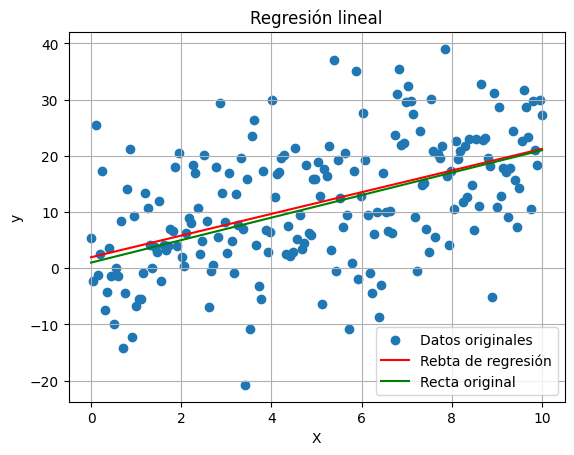

In [1]:
import numpy as np
import matplotlib.pyplot as plt


'''
**********************************
 Parámetros
**********************************
'''
# Parámetros de generación de datos lineales
n = 200  # Número de muestras
pendiente = 2
intercepto = 1
desviacion = 10  # Desviación estándar del ruido gaussiano
np.random.seed(5)

'''
**********************************
  Modelo (de regresion lineal)
**********************************
'''

def minimos_cuadrados(X, y):
    # Añadir una columna de unos a la matriz para tener en cuenta el término de intersección
    X = np.column_stack((np.ones(len(X)), X))
    # Calcular los coeficientes de regresión utilizando la fórmula de mínimos cuadrados
    coeficientes = np.linalg.inv(X.T @ X) @ X.T @ y
    return coeficientes


'''
**********************************
  Datos de entrenamiento
**********************************
'''
def generar_datos_lineales_con_ruido(n, pendiente, intercepto, desviacion):
    # Generar datos lineales
    X = np.linspace(0, 10, n)
    y = pendiente * X + intercepto
    # Agregar ruido gaussiano
    ruido = np.random.normal(0, desviacion, n)
    y += ruido

    return X, y



'''
**********************************
   Resultados y Gráfica
**********************************
'''
#Generacion de datos sintéticos
X, y = generar_datos_lineales_con_ruido(n, pendiente, intercepto, desviacion)
# Ajuste de regresión lineal
w_ordenada, w_pendiente = minimos_cuadrados(X, y)


# Imprimir coeficientes
print("Coeficientes de regresión:")
print("Ordenada al origen:", w_ordenada)
print("Pendiente:", w_pendiente)

# Gráfico
plt.scatter(X, y, label='Datos originales')
plt.plot(X, w_ordenada + w_pendiente * X, color='red', label='Rebta de regresión')
plt.plot(X,pendiente * X + intercepto, color='green', label='Recta original')
plt.xlabel('X')
plt.ylabel('y')
plt.title('Regresión lineal')
plt.legend()
plt.grid(True)
plt.show()


##<font color="orange" face="Comic Sans MS, Arial">Metodos iterativos

Como anteriormente se mencionó los métodos iterativos, son aquellos que dado un modelo producen aproximaciones sucesivas para los coeficientes de este con cada iteración. Algunos ejemplos de métodos iterativos de regresión incluyen

* Descenso de gradiente (Gradient Descent, GD)

* Descenso de gradiente estocástico (Stochastic Gradient Descent, SGD)

* Descenso de gradiente por lotes (Mini-Batch Gradient Descent)

* Método de Newton-Raphson

* Método de la matriz pseudoinversa (Método de Moore-Penrose)

A continución, se desarrollaran los metodos de descenso de gradiente y descenso de gradiente estocástico.

###<font color="orange" face="Comic Sans MS, Arial">Método de regresión lineal por decenso de gradiente

#### Gradient Descent ($w_0\in \mathbb{R}^d$ , $\eta>0$ ,  $T\in \mathbb{N}$)


El algoritmo de descenso de gradiente (Gradient Descent), ahora en adelante DG, es un proceso iterativo, que requiere tres especificaciones


*   $w_0$: Conjunto de parametros iniciales del modelo (en $ \mathbb{R}^d) $;
*   $\eta$:  Tamaño de paso (learning rate);
*   $T$: Número de iteraciones.


Descripción del Algoritmo:

1. ***Inicialización***: Comenzamos con valores iniciales para los parámetros del modelo $w_0$.
2. ***Iteración***: Repetimos los siguientes pasos hasta que se cumpla un criterio de detención:
   - Calculamos el gradiente de la función de costo promedio $f$ con respecto a los parámetros actuales, es decir, $\nabla_{w} f(w_t)$.
   - Actualizamos los parámetros utilizando la regla de actualización del descenso de gradiente, $w_{t+1} = w_t - η\nabla_{w} f(w_t)$, donde $η$ es la tasa de aprendizaje.
3. ***Finalización***: Detenemos el algoritmo después de un número predeterminado de iteraciones o cuando la mejora en la función de costo es pequeña.

 #### Regresión lineal por descenso de gradiente



El objetivo es encontrar $\operatorname{argmin}$ tal que

$$ \operatorname{argmin}  \frac{1}{n} \sum_{k=1}^n (h_w(x_i) - y_i)^2 .$$

Consideraremos que en este caso la funcion de perdida promedio $f$ se define como

$$f(w)= \sum_{i=1}^{N} (h_w(x_i) - y_i)^2
=\frac{1}{N} \sum_{k=1}^n( w_0 + w_1x - y)^2.$$

Se puede determinar que el gradiente en cada iteración es

$$\nabla_wf(w)= \frac{2}{N}\left( \sum_{i=1}^{N} ( w_0 + w_1x_i - y_i), \sum_{i=1}^{N} ( w_0 + w_1x_i - y_i)x_i\right) .$$

Por lo tanto la regla de actualizacion de $w$ es
$$
w_{t+1} = w_{t} - \eta  \frac{2}{N}\left( \sum_{i=1}^{N} ( w_0 + w_1x_i - y_i), \sum_{i=1}^{N} ( w_0 + w_1x_i - y_i)x_i\right).
$$

Luego, la expresion matricial equivalente es

$$
w_{t+1} = w_{t} -  \frac{2\eta }{N}\left( X^T(Xw_t-Y)\right).
$$

####Implementación

Coeficientes de regresión:
Ordenada al origen: 1.9374106731025165
Pendiente: 1.9307039698673354


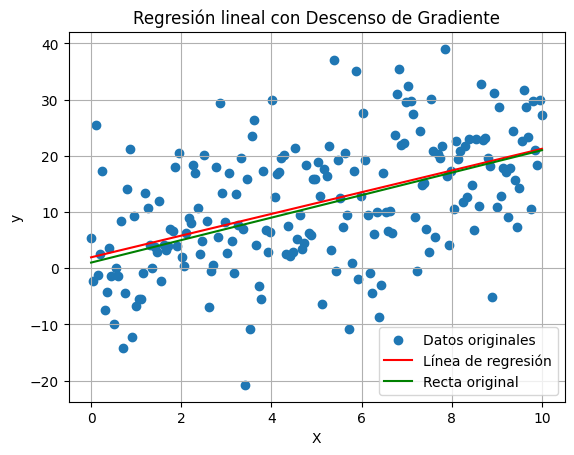

In [2]:
import numpy as np
import matplotlib.pyplot as plt

'''
**********************************
 Parámetros
**********************************
'''

# Parámetros de generación de datos lineales
n = 200  # Número de muestras
pendiente = 2
intercepto = 1
desviacion = 10  # Desviación estándar del ruido gaussiano
np.random.seed(5)

# Parámetros de ejecución del Gradient Descent
tasa_aprendizaje = 0.01  # Tasa de aprendizaje
iteraciones = 1000  # Número de iteraciones

'''
**********************************
  Modelo (de regresión lineal)
**********************************
'''

def regresion_lineal_gradient_descent(X, y, tasa_aprendizaje, iteraciones):

    X = np.column_stack((np.ones(len(X)), X))  # Añadir una columna de unos
    # Inicialización de coeficientes
    w = np.zeros(2)
    # Número de muestras
    m = len(X)
    # Gradiente descendente
    for iteracion in range(iteraciones):
        # Predicción
        y_pred = np.dot(X, w)
        # Actualización de coeficientes
        w -= (2 / m) * tasa_aprendizaje * (X.T.dot(y_pred - y))
    return w

'''
**********************************
  Datos de entrenamiento
**********************************
'''
def generar_datos_lineales_con_ruido(n, pendiente, intercepto, desviacion):
    # Generar datos lineales
    X = np.linspace(0, 10, n)
    y = pendiente * X + intercepto
    # Agregar ruido gaussiano
    ruido = np.random.normal(0, desviacion, n)
    y += ruido

    return X, y

X, y = generar_datos_lineales_con_ruido(n, pendiente, intercepto, desviacion)


'''
**********************************
   Resultados y Gráfica
**********************************
'''
# Ajuste de regresión lineal
w_ordenada,w_pendiente = regresion_lineal_gradient_descent(X, y, tasa_aprendizaje, iteraciones)

# Imprimir coeficientes
print("Coeficientes de regresión:")
print("Ordenada al origen:", w_ordenada)
print("Pendiente:", w_pendiente)

# Gráfico
plt.scatter(X, y, label='Datos originales')
plt.plot(X, w_ordenada+w_pendiente*X, color='red', label='Línea de regresión')
plt.plot(X,pendiente * X + intercepto, color='green', label='Recta original')
plt.xlabel('X')
plt.ylabel('y')
plt.title('Regresión lineal con Descenso de Gradiente')
plt.legend()
plt.grid(True)
plt.show()


#### Comportamiento de la funcion de perdida

Coeficientes de regresión:
Parámetros: [0.40556243 2.16108824]


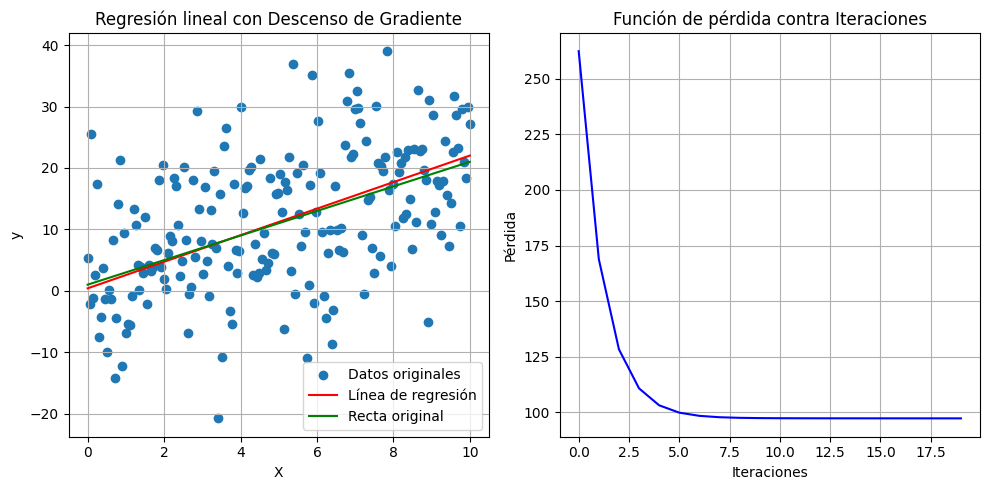

In [3]:
import numpy as np
import matplotlib.pyplot as plt

'''
**********************************
 Parámetros
**********************************
'''
# Parámetros de generación de datos lineales
n = 200  # Número de muestras
pendiente = 2
intercepto = 1
desviacion = 10  # Desviación estándar del ruido gaussiano
np.random.seed(5) # Semilla para reproductibilidad

# Parámetros de ejecución del Gradient Descent
tasa_aprendizaje = 0.01  # Tasa de aprendizaje
iteraciones = 20  # Número de iteraciones

'''
**********************************
  Modelo (de regresión lineal)
**********************************
'''

def regresion_lineal_gradient_descent(X, y, tasa_aprendizaje, iteraciones):

    X = np.column_stack((np.ones(len(X)), X))  # Añadir una columna de unos
    # Inicialización de coeficientes
    w = np.zeros(2)
    perdidas = []

    # Número de muestras
    m = len(X)

    # Gradiente descendente
    for iteracion in range(iteraciones):
        # Predicción
        y_pred = np.dot(X, w)

        # Cálculo de la pérdida
        perdida = np.mean((y_pred - y) ** 2)
        perdidas.append(perdida)

        # Actualización de coeficientes
        w -= (1 / m) * tasa_aprendizaje * (X.T.dot(y_pred - y))

    return w, perdidas

'''
**********************************
  Datos de entrenamiento
**********************************
'''
def generar_datos_lineales_con_ruido(n, pendiente, intercepto, desviacion):
    # Generar datos lineales
    X = np.linspace(0, 10, n)
    y = pendiente * X + intercepto
    # Agregar ruido gaussiano
    ruido = np.random.normal(0, desviacion, n)
    y += ruido

    return X, y

X, y = generar_datos_lineales_con_ruido(n, pendiente, intercepto, desviacion)


'''
**********************************
   Resultados y Gráfica
**********************************
'''
# Ajuste de regresión lineal
w, perdidas = regresion_lineal_gradient_descent(X, y, tasa_aprendizaje, iteraciones)

# Imprimir coeficientes
print("Coeficientes de regresión:")
print("Parámetros:", w)

# Gráfico de regresión lineal
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.scatter(X, y, label='Datos originales')
plt.plot(X, w[0] + w[1] * X, color='red', label='Línea de regresión')
plt.plot(X,pendiente * X + intercepto, color='green', label='Recta original')


plt.xlabel('X')
plt.ylabel('y')
plt.title('Regresión lineal con Descenso de Gradiente')
plt.legend()
plt.grid(True)

# Gráfico de la función de pérdida
plt.subplot(1, 2, 2)
plt.plot(range(iteraciones), perdidas, color='blue')
plt.xlabel('Iteraciones')
plt.ylabel('Pérdida')
plt.title('Función de pérdida contra Iteraciones')
plt.grid(True)

plt.tight_layout()
plt.show()



#### <font color="orange" face="Comic Sans MS, Arial">Animación

In [4]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation, rc
from IPython.display import HTML

'''
**********************************
 Parámetros
**********************************
'''

# Parámetros de generación de datos lineales
n = 200  # Número de muestras
pendiente = 2
intercepto = 1
desviacion = 10  # Desviación estándar del ruido gaussiano
np.random.seed(5)

# Parámetros de ejecución del Gradient Descent
tasa_aprendizaje = 0.01  # Tasa de aprendizaje
iteraciones = 100  # Número de iteraciones


'''
**********************************
  Datos de entrenamiento (sintéticos)
**********************************
'''

def generar_datos_lineales_con_ruido(n, pendiente, intercepto, desviacion):
    # Generar datos lineales
    X = np.linspace(0, 10, n)
    X = np.column_stack((np.ones(len(X)), X))  # Agregar una columna de unos para el término de sesgo
    y = pendiente * X[:, 1] + intercepto
    # Agregar ruido gaussiano
    ruido = np.random.normal(0, desviacion, n)
    y += ruido

    return X, y

'''
**********************************
  Modelo (descenso de gradiente)
**********************************
'''

def descenso_gradiente(X, y, tasa_aprendizaje, iteraciones):

    # Inicialización de coeficientes
    w = np.zeros(2)
    m = len(X)

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

    # Gráfica de dispersión de los datos
    ax1.scatter(X[:, 1], y, label='Datos')
    line, = ax1.plot([], [], lw=2, color='red', label='Recta ajustada')  # Cambiar el color de la línea a rojo
    ax1.set_xlabel('X')
    ax1.set_ylabel('y')
    ax1.set_title('Descenso de Gradiente')
    text = ax1.text(0.02, 0.95, '', transform=ax1.transAxes)
    ax1.plot([], [], color='green', linestyle='-', label='Recta original')  # Agrega una línea vacía para la leyenda

    # Agrega la leyenda
    ax1.legend(loc='lower right')

    # Inicialización de la gráfica de la función de pérdida
    ax2.set_xlabel('Iteración')
    ax2.set_ylabel('Pérdida')
    ax2.set_title('Pérdida en el tiempo')
    losses = []

    def init():
        line.set_data([], [])
        text.set_text('')
        return line, text,

    def update(iteracion):
        nonlocal w, losses
        # Predicción
        y_pred = np.dot(X, w)
        # Cálculo de la pérdida
        loss = np.mean((y_pred - y) ** 2)
        losses.append(loss)
        # Actualización de coeficientes
        w -= (1 / m) * tasa_aprendizaje * (X.T.dot(y_pred - y))
        line.set_data(X[:, 1], y_pred)

        # Calcula y traza la línea recta original
        y_original = pendiente * X[:, 1] + intercepto
        ax1.plot(X[:, 1], y_original, color='green', linestyle='-')

        text.set_text(f'Iteración: {iteracion}\nParámetros: {w}')
        ax2.plot(range(iteracion + 1), losses, color='blue')
        return line, text,

    animacion = animation.FuncAnimation(fig, update, frames=range(iteraciones), init_func=init, blit=True)

    plt.close()  # Cierra la figura después de la animación para evitar que se muestre dos veces

    return animacion

X, y = generar_datos_lineales_con_ruido(n, pendiente, intercepto, desviacion)
animacion = descenso_gradiente(X, y, tasa_aprendizaje, iteraciones)

# Nota: esta parte es lo que hace que funcione la animacion en colab
rc('animation', html='jshtml')
animacion

###Método de regresión lineal por decenso de gradiente estocástico en lotes

### Mini-batch (Stochastic) gradient decent ($\omega_0\in \mathbb{R}^d,\eta>0, T\in\mathbb{N}$)


En español el gradiente descendiente estocástico (Stochastic gradient decent) es un proceso bastante similar al GD, solo que en este se toma una cantidad menor de datos que se toman en cuenta al calcular la función de perdida, lo que lo hace más eficiente. Y nuevamente este requiere de tres especificaciones que son las mismas para el algoritmo GD.

 ***Descripción del algoritmo***


1. Inicialización: Se eligen valores iniciales para los parámetros del modelo $\mathbf{w}_0$.
2. Selección Estocástica: Se toma un lote (batch) de datos al azar.
3. Iteración: Se repiten los siguientes pasos hasta que se cumpla un criterio de detención:
   - Se selecciona aleatoriamente un subconjunto de datos de entrenamiento.
   - Se calcula el gradiente de la función de costo utilizando solo los datos en el subconjunto seleccionado: $\nabla\sum_{i \in B_{t+1}}l(w,z_i)$
   - Se actualizan los parámetros utilizando la regla de actualización del descenso de gradiente: $$\mathbf{w}_{t+1} = \mathbf{w}_t - \frac{\eta}{|B_{t+1}|} \nabla\sum_{i \in B_{t+1}}l(w,z_i)$$
4. Finalización: Se detiene el algoritmo después de un número predeterminado de iteraciones $T$ o se llega a un umbral de convergencia.


Comentario. Los minilotes (mini-batches) $B_1,\dots,B_n$ pueden ser tomados de muchas maneras, por ejemplo
$$B_t\sim Unif([n]) \text{    o    } B_t=[n]$$

### Regresión lineal por descenso de gradiente estocástico por lotes

Similarmente al caso de descenso por gradiente, la función de actualización está determinada por

\begin{align*}
w_{t+1} =& w_t - \frac{\eta}{|B_{t+1}|} \nabla_w \sum_{i \in B_{t+1}}l(w,(X_i, Y_i))\\
=& w_t - \frac{2\eta}{|B_{t+1}|} \sum_{i \in B_{t+1}}( X_iw_i -Y_i)X_i \\
=& w_t - \frac{\eta}{|B_{t+1}|} X_{B_{t+1}}^T(X_{B_{t+1}}w_t - Y_{B_{t+1}}).\\
\end{align*}

Donde $w$ es el vector de pesos que estamos optimizando, $B_{t+1}$ es el minibatch seleccionado en la iteración $t+1$, $\eta$ es la tasa de aprendizaje, $X_i$ es el vector de características del ejemplo $i$-esimo, $Y_i$ es la etiqueta correspondiente al ejemplo $i$-esimo, y $l$ es la función de pérdida.


####Implementación

Coeficientes de regresión:
Parámetros: [1.74979435 1.89904199]


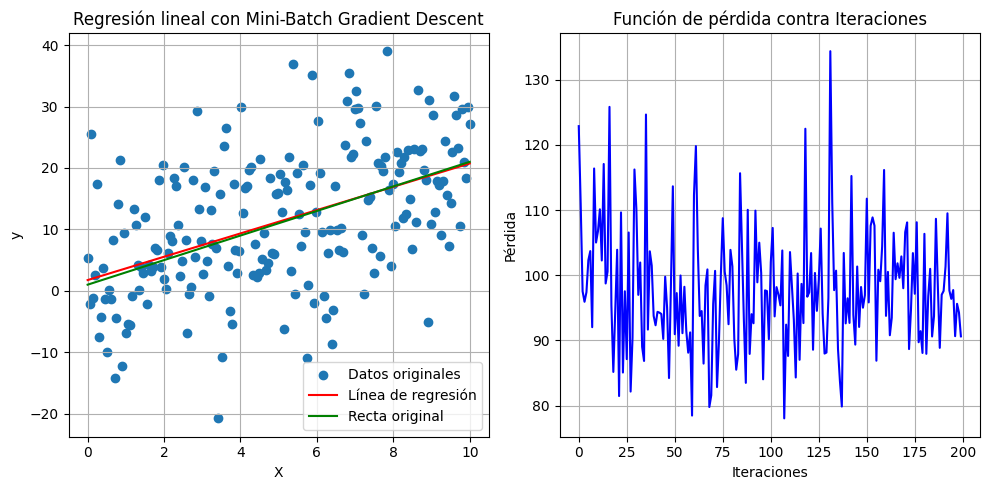

In [5]:
import numpy as np
import matplotlib.pyplot as plt

'''
**********************************
 Parámetros
**********************************
'''

# Parámetros de generación de datos lineales
n = 200  # Número de muestras
pendiente = 2
intercepto = 1
desviacion = 10  # Desviación estándar del ruido gaussiano
np.random.seed(5) # Semilla para reproductibilidad

# Parámetros de ejecución del Gradient Descent
tasa_aprendizaje = 0.01  # Tasa de aprendizaje
iteraciones = 200  # Número de iteraciones

'''
**********************************
  Modelo (de regresión lineal)
**********************************
'''
def regresion_lineal_minibatch(X, y, tasa_aprendizaje, iteraciones, tamano_minibatch):
    X = np.column_stack((np.ones(len(X)), X))  # Añadir una columna de unos para el término de sesgo
    # Inicialización de coeficientes
    w = np.zeros(2)
    perdidas = []

    # Número de muestras
    m = len(X)

    # Mini-batch Gradient Descent
    for _ in range(iteraciones):
        perdida_total = 0
        for _ in range(0, m, tamano_minibatch):
            # Selección de un mini-lote aleatorio
            #Genera un vector con m entradas de indices que no se repiten

            indices_minibatch = np.random.choice(range(m), size=tamano_minibatch, replace=False)
            y_minibatch = y[indices_minibatch]
            X_minibatch = X[indices_minibatch]
            # Predicción
            y_pred = np.dot(X_minibatch, w)

            # Cálculo de la pérdida
            perdida = np.mean((y_pred - y_minibatch) ** 2)
            perdida_total += perdida

            # Actualización de coeficientes
            gradiente = np.dot(X_minibatch.T, (y_pred - y_minibatch)) / tamano_minibatch
            w -= tasa_aprendizaje * gradiente

        # Calcular la pérdida promedio para esta iteración
        perdida_promedio = perdida_total / (m / tamano_minibatch)
        perdidas.append(perdida_promedio)

    return w, perdidas

'''
**********************************
  Datos de entrenamiento (sintéticos)
**********************************
'''
def generar_datos_lineales_con_ruido(n, pendiente, intercepto, desviacion):
    # Generar datos lineales
    X = np.linspace(0, 10, n)
    y = pendiente * X + intercepto
    # Agregar ruido gaussiano
    ruido = np.random.normal(0, desviacion, n)
    y += ruido

    return X, y

X, y = generar_datos_lineales_con_ruido(n, pendiente, intercepto, desviacion)



'''
**********************************
   Resultados y Gráfica
**********************************
'''
# Ajuste de regresión lineal con Mini-Batch Gradient Descent
w, perdidas = regresion_lineal_minibatch(X, y, tasa_aprendizaje, iteraciones, tamano_minibatch=20)

# Imprimir coeficientes
print("Coeficientes de regresión:")
print("Parámetros:", w)

# Gráfico
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.scatter(X, y, label='Datos originales')
plt.plot(X, w[0] + w[1] * X, color='red', label='Línea de regresión')
plt.plot(X,pendiente * X + intercepto, color='green', label='Recta original')
plt.xlabel('X')
plt.ylabel('y')
plt.title('Regresión lineal con Mini-Batch Gradient Descent')
plt.legend()
plt.grid(True)

# Gráfico de la función de pérdida
plt.subplot(1, 2, 2)
plt.plot(range(iteraciones), perdidas, color='blue')
plt.xlabel('Iteraciones')
plt.ylabel('Pérdida')
plt.title('Función de pérdida contra Iteraciones')
plt.grid(True)

plt.tight_layout()
plt.show()

#<font color="orange" face="Comic Sans MS, Arial">Animación

In [6]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation, rc
from IPython.display import HTML

# Parámetros
n = 200  # Número de muestras
pendiente = 2
intercepto = 1
desviacion = 10  # Desviación estándar del ruido gaussiano
np.random.seed(5)
tasa_aprendizaje = 0.001  # Tasa de aprendizaje
iteraciones = 100  # Número de iteraciones

# Datos de entrenamiento
def generar_datos_lineales_con_ruido(n, pendiente, intercepto, desviacion):
    # Genera datos lineales con ruido gaussiano
    X = np.linspace(0, 10, n)
    X = np.column_stack((np.ones(len(X)), X))  # Agrega una columna de unos para el término de sesgo
    y = pendiente * X[:, 1] + intercepto
    ruido = np.random.normal(0, desviacion, n)
    y += ruido
    return X, y

# Descenso de Gradiente con minibatch
def descenso_gradiente_minibatch(X, y, tasa_aprendizaje, iteraciones, tamano_minibatch):
    # Inicialización de coeficientes
    w = np.zeros(2)
    m = len(X)

    # Creación de la figura y los ejes
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

    # Gráfico de dispersión de los datos y recta original
    ax1.scatter(X[:, 1], y)
    linea, = ax1.plot([], [], lw=2, color='red', label='Recta ajustada')  # Línea para la recta ajustada
    ax1.set_xlabel('X')
    ax1.set_ylabel('y')
    ax1.set_title('Descenso de Gradiente')
    texto = ax1.text(0.02, 0.95, '', transform=ax1.transAxes)  # Texto para mostrar parámetros en cada iteración
    ax1.plot(X[:, 1], pendiente * X[:, 1] + intercepto, color='green', linestyle='-', label='Recta original')  # Recta original con los datos
    ax1.legend(loc='lower right')  # Agrega la leyenda

    # Configuración del segundo gráfico para mostrar la pérdida
    ax2.set_xlabel('Iteración')
    ax2.set_ylabel('Pérdida')
    ax2.set_title('Pérdida en el tiempo')

    perdidas_por_lote_line, = ax2.plot([], [], color='blue', label='Pérdida por lote')
    perdidas_totales_line, = ax2.plot([], [], color='green', label='Pérdida total')
    ax2.legend()  # Agrega la leyenda para ambas líneas de pérdida

    perdidas_por_lote = []  # Lista para almacenar la pérdida por lote
    perdidas_totales = []  # Lista para almacenar la pérdida total durante cada iteración

    # Función de inicialización para la animación
    def init():
        linea.set_data([], [])
        texto.set_text('')
        perdidas_por_lote_line.set_data([], [])
        perdidas_totales_line.set_data([], [])
        return linea, texto, perdidas_por_lote_line, perdidas_totales_line,

    # Función de actualización para la animación
    def update(iteracion):
        nonlocal w, perdidas_por_lote, perdidas_totales
        indices_minilote = np.random.choice(range(m), size=tamano_minibatch, replace=False)  # Selección de un minibatch aleatorio
        X_minilote = X[indices_minilote]
        y_minilote = y[indices_minilote]
        y_pred = np.dot(X_minilote, w)

        # Cálculo de la pérdida por lote y total
        perdida_por_lote = np.mean((y_pred - y_minilote) ** 2)
        perdidas_por_lote.append(perdida_por_lote)
        y_pred_total = np.dot(X, w)
        perdida_total = np.mean((y_pred_total - y) ** 2)
        perdidas_totales.append(perdida_total)

        # Actualización de coeficientes
        gradiente = np.dot(X_minilote.T, (y_pred - y_minilote)) / tamano_minibatch
        w -= tasa_aprendizaje * gradiente

        # Actualiza la recta ajustada y muestra los parámetros en el texto
        linea.set_data(X[:, 1], np.dot(X, w))
        texto.set_text(f'Iteración: {iteracion}\nParámetros: {w}')

        # Actualiza las líneas de pérdida
        perdidas_por_lote_line.set_data(range(iteracion + 1), perdidas_por_lote)
        perdidas_por_lote_line.axes.set_xlim(0, iteraciones)
        perdidas_por_lote_line.axes.set_ylim(0, max(max(perdidas_por_lote), max(perdidas_totales)))

        perdidas_totales_line.set_data(range(iteracion + 1), perdidas_totales)
        perdidas_totales_line.axes.set_xlim(0, iteraciones)
        perdidas_totales_line.axes.set_ylim(0, max(max(perdidas_por_lote), max(perdidas_totales)))

        return linea, texto, perdidas_por_lote_line, perdidas_totales_line,

    # Creación de la animación
    animacion = animation.FuncAnimation(fig, update, frames=range(iteraciones), init_func=init, blit=True)

    # Cierra la figura después de la animación para evitar que se muestre dos veces
    plt.close()

    return animacion

# Genera datos sintéticos
X, y = generar_datos_lineales_con_ruido(n, pendiente, intercepto, desviacion)

# Genera la animación del descenso de gradiente
animacion_minilote = descenso_gradiente_minibatch(X, y, tasa_aprendizaje, iteraciones, tamano_minibatch=10)

# Muestra la animación en el notebook
rc('animation', html='jshtml')
animacion_minilote
